In [131]:
#################################################################################
# Author: Paulina Arregocés Guerra
# Research groups 
# GITA (Applied Telecommunications Research Group)  - Universidad de Antioquia 
# GIDIA (Artificial Intelligence Research Group) - Universidad Nacional de Colombia
#
# Last modified on 13/06/2023 
# Desciotion: This code is used to label the dataset and to train and test the decision # tree and support vector machine models with real data. 
#################################################################################

' Author: Paulina Arregocés \n    Ultima actualización: 02 de noviembre de 2022\n\n    Observaciones: Se realiza la comparación del modelo Sigmoide para continuar con el resto de comparaciones\n'

In [ ]:
# Select your preferences and run the install command...https://pytorch.org/
#!pip3 install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cpu

# Uncomment for requirement libraries versions
#!pip install -r requirements.txt 

# Comparison Models for BNN's

In [1]:
import os 
import pandas as pd
import numpy as np
import torch
import torchvision
import torch.optim as optim
import torch.nn as nn 
from torch.utils.data import Dataset 
import torch.nn.functional as F
from torch.autograd import Variable
from torch.utils.data.sampler import WeightedRandomSampler

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MaxAbsScaler, StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from random import random

import matplotlib.pyplot as plt

import pickle

print('Libraries fully imported')

Libraries fully imported


### Set Train, Validation and Test Data

In [2]:
def transform_data(target_train,target_val,target_test,input_train,input_val,input_test):
    
    label_train =torch.from_numpy(np.loadtxt(target_train, dtype=int)) 
    label_val =torch.from_numpy(np.loadtxt(target_val, dtype=int)) 
    label_test =torch.from_numpy(np.loadtxt(target_test, dtype=int)) 
    input_train =torch.torch.Tensor(np.loadtxt(input_train, dtype=int))
    input_val =torch.torch.Tensor(np.loadtxt(input_val, dtype=int)) 
    input_test =torch.torch.Tensor(np.loadtxt(input_test, dtype=int))
    train = torch.utils.data.TensorDataset(input_train, label_train) 
    val = torch.utils.data.TensorDataset(input_val, label_val)
    test = torch.utils.data.TensorDataset(input_test, label_test)
        
    return train, val, test

In [3]:
# Coded Data
trainNN, valNN ,testNN= transform_data('./CSV_TXT/target_train.txt','./CSV_TXT/target_val.txt','./CSV_TXT/target_test.txt','./CSV_TXT/features_train.txt','./CSV_TXT/features_val.txt','./CSV_TXT/features_test.txt')
# Binary Data
train_Bin,val_Bin ,test_Bin= transform_data('./CSV_TXT/target_train_Bin.txt','./CSV_TXT/target_val_Bin.txt','./CSV_TXT/target_test_Bin.txt','./CSV_TXT/features_train_Bin.txt','./CSV_TXT/features_val_Bin.txt','./CSV_TXT/features_test_Bin.txt')   

## Artificial Neural Networks Models

### Architecture models

In [4]:
# Sigmoid 
class NetSigmoid(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetSigmoid, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = torch.sigmoid(self.layer1(x)) 
        x2 = torch.sigmoid(self.layer2(x1))
        return x2 

# Instantiate the model 
model_Sigmoid = NetSigmoid(80, 1) 

In [5]:
# Relu
class NetRelu(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetRelu, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = F.relu(self.layer1(x)) 
        x2 = self.layer2(x1)
        return x2 

# Instantiate the model 
model_Relu = NetRelu(80, 1) 

In [6]:
# Tanh
class NetTanh(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetTanh, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = torch.tanh(self.layer1(x)) 
        x2 = self.layer2(x1)
        return x2 

# Instantiate the model 
model_tanh = NetTanh(80, 1) 

In [7]:
# Define Binary Neural Network 

class BinaryNeuralNetwork(nn.Module):
    
    def __init__(self, Weights_L1, Weights_L2):
        super(BinaryNeuralNetwork, self).__init__()
        #Weights obteined from NN's control plane 
        self.synaptic_weights_lay1 = Weights_L1.T
        self.synaptic_weights_lay2 = Weights_L2.T

    def sign(self, x):
        #applying the sign function
        z= []
        for i in range(len(x)):
            if (x[i] > 0).any() : z.append(1)
            if (x[i] <= 0).any(): z.append(-1)
        return np.array(z)


    def forward(self, inputs):
        #passing the inputs via the neuron to get output   
        results=[]
        for i in inputs:
            print(inputs,i)
            output1 = self.sign(np.dot(i, self.synaptic_weights_lay1))
            output2 = self.sign(np.dot(output1, self.synaptic_weights_lay2))
            results.append(output2)
            
        return torch.Tensor(list(results)) 

In [8]:
# Define all preds 
def get_all_preds(model, loader):
    all_preds = torch.tensor([])
    all_labels = torch.tensor([])
    c=0
    for batch in loader:
        c=c+1
        if c>=100: break
        data, labels = batch
        preds = model(data.view(-1,80))
        all_preds = torch.cat(
            (all_preds, preds)
            ,dim=0
        )
        all_labels= torch.cat(
            (all_labels,labels)
            ,dim=0
        )
        
    return all_preds, all_labels

### Model's Comparation 

In [9]:
def Cargar_Modelos(path,arch):
    path=path
    model_arch=arch
    model_arch.load_state_dict(torch.load(path))
    
    return model_arch.eval()

In [11]:
# Sigmoide Models
Model_Sigmoid_1= Cargar_Modelos(path='./MODELS/Sigmoid/CIC_model_Sigmoid1.pth',arch=model_Sigmoid)
Model_Sigmoid_2= Cargar_Modelos(path='./MODELS/Sigmoid/CIC_model_Sigmoid2.pth',arch=model_Sigmoid)
Model_Sigmoid_3= Cargar_Modelos(path='./MODELS/Sigmoid/CIC_model_Sigmoid3.pth',arch=model_Sigmoid)
Model_Sigmoid_4= Cargar_Modelos(path='./MODELS/Sigmoid/CIC_model_Sigmoid4.pth',arch=model_Sigmoid)
Model_Sigmoid_5= Cargar_Modelos(path='./MODELS/Sigmoid/CIC_model_Sigmoid5.pth',arch=model_Sigmoid)
Model_Sigmoid_6= Cargar_Modelos(path='./MODELS/Sigmoid/CIC_model_Sigmoid6.pth',arch=model_Sigmoid)
Model_Sigmoid_7= Cargar_Modelos(path='./MODELS/Sigmoid/CIC_model_Sigmoid7.pth',arch=model_Sigmoid)
Model_Sigmoid_8= Cargar_Modelos(path='./MODELS/Sigmoid/CIC_model_Sigmoid8.pth',arch=model_Sigmoid)


In [12]:
# ReLU Models
Model_RelU_1= Cargar_Modelos(path='./MODELS/ReLU/CIC_model_RelU1.pth',arch=model_Relu)
Model_RelU_2= Cargar_Modelos(path='./MODELS/ReLU/CIC_model_RelU2.pth',arch=model_Relu)
Model_RelU_3= Cargar_Modelos(path='./MODELS/ReLU/CIC_model_RelU3.pth',arch=model_Relu)
Model_RelU_4= Cargar_Modelos(path='./MODELS/ReLU/CIC_model_RelU4.pth',arch=model_Relu)
Model_RelU_5= Cargar_Modelos(path='./MODELS/ReLU/CIC_model_RelU5.pth',arch=model_Relu)
Model_RelU_6= Cargar_Modelos(path='./MODELS/ReLU/CIC_model_RelU6.pth',arch=model_Relu)
Model_RelU_7= Cargar_Modelos(path='./MODELS/ReLU/CIC_model_RelU7.pth',arch=model_Relu)
Model_RelU_8= Cargar_Modelos(path='./MODELS/ReLU/CIC_model_RelU8.pth',arch=model_Relu)


In [13]:
# Tanh  Models
Model_Tanh_1= Cargar_Modelos(path='./MODELS/Tanh/CIC_model_Tanh1.pth',arch=model_tanh)
Model_Tanh_2= Cargar_Modelos(path='./MODELS/Tanh/CIC_model_Tanh2.pth',arch=model_tanh)
Model_Tanh_3= Cargar_Modelos(path='./MODELS/Tanh/CIC_model_Tanh3.pth',arch=model_tanh)
Model_Tanh_4= Cargar_Modelos(path='./MODELS/Tanh/CIC_model_Tanh4.pth',arch=model_tanh)
Model_Tanh_5= Cargar_Modelos(path='./MODELS/Tanh/CIC_model_Tanh5.pth',arch=model_tanh)
Model_Tanh_6= Cargar_Modelos(path='./MODELS/Tanh/CIC_model_Tanh6.pth',arch=model_tanh)
Model_Tanh_7= Cargar_Modelos(path='./MODELS/Tanh/CIC_model_Tanh7.pth',arch=model_tanh)
Model_Tanh_8= Cargar_Modelos(path='./MODELS/Tanh/CIC_model_Tanh8.pth',arch=model_tanh)


In [14]:
# Extraction and binarize weights

def Binarize(tensor,quant_mode='det'):
    if quant_mode=='det':
        return tensor.sign()
    
def weigths2(model_arch):
    try:
        trained_weights_lay1 = model_arch.layer1.weight
        trained_weights_lay2 = model_arch.layer2.weight
        Weight_lay1_Bin=Binarize(trained_weights_lay1)
        Weight_lay2_Bin=Binarize(trained_weights_lay2)
        return Weight_lay1_Bin, Weight_lay2_Bin
    except:
        print('No valid Model')


In [15]:
def Metrics(nombre, y_test_true,y_test_pred):

  model_metrics=[]
  model_metrics.append(nombre)

  tn, fp, fn, tp = confusion_matrix(y_true=y_test_true, y_pred=y_test_pred).ravel()

  Accuracy = (tp + tn) / (tp + tn + fp + fn)
  model_metrics.append(Accuracy)

  Precision =  tp / (tp + fp)
  model_metrics.append(Precision)

  Recall = tp / (tp + fn)
  model_metrics.append(Recall)

  f1_score = 2*(Precision*Recall)/(Precision+Recall)
  model_metrics.append(f1_score)

  Error_rate = (fp + fn) / (tp + tn + fp + fn)
  model_metrics.append(Error_rate)

  Specifity = tn / (tn + fp)
  model_metrics.append(Specifity)

  False_negative_rate= fn / (tp + fn)
  model_metrics.append(False_negative_rate)

  False_positive_rate= fp / (tn + fp)
  model_metrics.append(False_positive_rate)

  with open(nombre, "wb") as f:
    pickle.dump(model_metrics, f)

  return model_metrics

#### Sigmoid Model's Comparations

In [16]:
# Define weights for Sigmoid Function
L1_sig1,L2_sig1=weigths2(Model_Sigmoid_1)
L1_sig2,L2_sig2=weigths2(Model_Sigmoid_2)
L1_sig3,L2_sig3=weigths2(Model_Sigmoid_3)
L1_sig4,L2_sig4=weigths2(Model_Sigmoid_4)
L1_sig5,L2_sig5=weigths2(Model_Sigmoid_5)
L1_sig6,L2_sig6=weigths2(Model_Sigmoid_6)
L1_sig7,L2_sig7=weigths2(Model_Sigmoid_7)
L1_sig8,L2_sig8=weigths2(Model_Sigmoid_8)


binary_sigmoid1 = BinaryNeuralNetwork(L1_sig1,L2_sig1)
binary_sigmoid2 = BinaryNeuralNetwork(L1_sig2,L2_sig2)
binary_sigmoid3 = BinaryNeuralNetwork(L1_sig3,L2_sig3)
binary_sigmoid4 = BinaryNeuralNetwork(L1_sig4,L2_sig4)
binary_sigmoid5 = BinaryNeuralNetwork(L1_sig5,L2_sig5)
binary_sigmoid6 = BinaryNeuralNetwork(L1_sig6,L2_sig6)
binary_sigmoid7 = BinaryNeuralNetwork(L1_sig7,L2_sig7)
binary_sigmoid8 = BinaryNeuralNetwork(L1_sig8,L2_sig8)

In [17]:
train_batch = torch.utils.data.DataLoader(train_Bin, batch_size=100, shuffle=True)
val_batch = torch.utils.data.DataLoader(val_Bin, batch_size=100, shuffle=True)
test_batch = torch.utils.data.DataLoader(test_Bin, batch_size=100, shuffle=True)

In [18]:
# Descomentar y correr de a uno! 
with torch.no_grad():
    prediction_loader = test_batch
    #test_preds_Sigmoid1, test_labels_Sigmoid1 = get_all_preds(binary_sigmoid1, prediction_loader)
    #test_preds_Sigmoid2, test_labels_Sigmoid2 = get_all_preds(binary_sigmoid2, prediction_loader)
    #test_preds_Sigmoid3, test_labels_Sigmoid3 = get_all_preds(binary_sigmoid3, prediction_loader)
    #test_preds_Sigmoid4, test_labels_Sigmoid4 = get_all_preds(binary_sigmoid4, prediction_loader)
    #test_preds_Sigmoid5, test_labels_Sigmoid5 = get_all_preds(binary_sigmoid5, prediction_loader)
    #test_preds_Sigmoid6, test_labels_Sigmoid6 = get_all_preds(binary_sigmoid6, prediction_loader)
    #test_preds_Sigmoid7, test_labels_Sigmoid7 = get_all_preds(binary_sigmoid7, prediction_loader)
    test_preds_Sigmoid8, test_labels_Sigmoid8 = get_all_preds(binary_sigmoid8, prediction_loader)
    #test_preds_Sigmoid9, test_labels_Sigmoid9 = get_all_preds(binary_sigmoid9, prediction_loader)
    #test_preds_Sigmoid10, test_labels_Sigmoid10 = get_all_preds(binary_sigmoid10, prediction_loader)
    #test_preds_Sigmoid11, test_labels_Sigmoid11 = get_all_preds(binary_sigmoid11, prediction_loader)
    #test_preds_Sigmoid12, test_labels_Sigmoid12 = get_all_preds(binary_sigmoid12, prediction_loader)
    #test_preds_Sigmoid13, test_labels_Sigmoid13 = get_all_preds(binary_sigmoid13, prediction_loader)

tensor([[ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ..., -1.,  1., -1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1., -1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,
         1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.])
tensor([[ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ..., -1.,  1., -1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,

C:\Users\Informatica\AppData\Local\Temp\ipykernel_10708\1148372165.py:29: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ..\torch\csrc\utils\tensor_new.cpp:248.)
  return torch.Tensor(list(results))


tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        -1., -1.,  1., -1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1.])
tensor([[ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,
         1., -1.,  1.,  1.,

In [19]:
Sigmoid8_metrics= Metrics('Sigmoid8',test_preds_Sigmoid8, test_labels_Sigmoid8)
print(Sigmoid8_metrics)

['Sigmoid8', 0.785050505050505, 0.8035889070146819, 0.8420512820512821, 0.8223706176961603, 0.21494949494949495, 0.702716049382716, 0.15794871794871795, 0.29728395061728397]


In [20]:
with open("Sigmoid8", "rb") as f:
    obj = pickle.load(f)
print(obj)

['Sigmoid8', 0.785050505050505, 0.8035889070146819, 0.8420512820512821, 0.8223706176961603, 0.21494949494949495, 0.702716049382716, 0.15794871794871795, 0.29728395061728397]


In [21]:
# Run after saving all Sigmoid_metrics 
def costr_list(model_n):
    results=[]
    if model_n == 'Sigmoid':
        for i in range(1,9):
            model_name= "Sigmoid"+str(i)
            with open (model_name, "rb") as f:
                obj = pickle.load(f)
            results.append(obj)
    if model_n == 'Relu':
        for i in range(1,9):
            model_name= "Relu"+str(i)
            with open (model_name, "rb") as f:
                obj = pickle.load(f)
            results.append(obj)
    if model_n == 'Tanh':
        for i in range(1,9):
            model_name= "Tanh"+str(i)
            with open (model_name, "rb") as f:
                obj = pickle.load(f)
            results.append(obj)
    return results


In [23]:
# From here uncomment when you save 8 models to test performance
#df_Sigmoid = pd.DataFrame.from_records(costr_list('Sigmoid'), columns=['Model_name', 'Accuracy', ' Precision', 'Recall', 'f1_score', 'Error_rate', 'Specifity', 'False_negative_rate', 'False_positive_rate' ], index="Model_name")

In [50]:
#df_Sigmoid

,Accuracy,Precision,Recall,f1_score,Error_rate,Specifity,False_negative_rate,False_positive_rate
Model_name,,,,,,,,
Sigmoid1,0.786869,0.803854,0.844109,0.823490,0.213131,0.704841,0.155891,0.295159
Sigmoid2,0.786667,0.796962,0.848817,0.822072,0.213333,0.700626,0.151183,0.299374
Sigmoid3,0.792525,0.808077,0.847598,0.827366,0.207475,0.714390,0.152402,0.285610
Sigmoid4,0.515960,0.582240,0.618736,0.599933,0.484040,0.370144,0.381264,0.629856
Sigmoid5,0.794444,0.814589,0.844775,0.829407,0.205556,0.721563,0.155225,0.278437
Sigmoid6,0.793939,0.811026,0.850298,0.830198,0.206061,0.712020,0.149702,0.287980
Sigmoid7,0.788182,0.799935,0.850130,0.824269,0.211818,0.701094,0.149870,0.298906
Sigmoid8,0.787576,0.805803,0.840874,0.822965,0.212424,0.711769,0.159126,0.288231


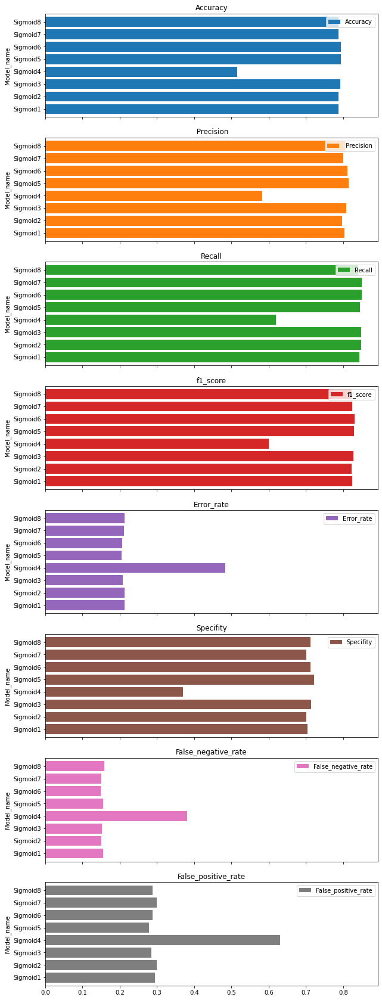

In [51]:
# Uncomment to plot
'''
df_Sigmoid.plot(kind = 'barh',
    width=0.8,
    subplots=True,
    figsize=(10,30));'''

#### Relu Model's Comparations 

In [24]:
# Define weights for Sigmoid Function
L1_relu1,L2_relu1=weigths2(Model_RelU_1)
L1_relu2,L2_relu2=weigths2(Model_RelU_2)
L1_relu3,L2_relu3=weigths2(Model_RelU_3)
L1_relu4,L2_relu4=weigths2(Model_RelU_4)
L1_relu5,L2_relu5=weigths2(Model_RelU_5)
L1_relu6,L2_relu6=weigths2(Model_RelU_6)
L1_relu7,L2_relu7=weigths2(Model_RelU_7)
L1_relu8,L2_relu8=weigths2(Model_RelU_8)


binary_relu1 = BinaryNeuralNetwork(L1_relu1,L2_relu1)
binary_relu2 = BinaryNeuralNetwork(L1_relu2,L2_relu2)
binary_relu3 = BinaryNeuralNetwork(L1_relu3,L2_relu3)
binary_relu4 = BinaryNeuralNetwork(L1_relu4,L2_relu4)
binary_relu5 = BinaryNeuralNetwork(L1_relu5,L2_relu5)
binary_relu6 = BinaryNeuralNetwork(L1_relu6,L2_relu6)
binary_relu7 = BinaryNeuralNetwork(L1_relu7,L2_relu7)
binary_relu8 = BinaryNeuralNetwork(L1_relu8,L2_relu8)


In [25]:
# Descomentar y correr de a uno! 
with torch.no_grad():
    prediction_loader = test_batch
    #test_preds_Relu1, test_labels_Relu1 = get_all_preds(binary_relu1, prediction_loader)
    #test_preds_Relu2, test_labels_Relu2 = get_all_preds(binary_relu2, prediction_loader)
    #test_preds_Relu3, test_labels_Relu3 = get_all_preds(binary_relu3, prediction_loader)
    #test_preds_Relu4, test_labels_Relu4 = get_all_preds(binary_relu4, prediction_loader)
    #test_preds_Relu5, test_labels_Relu5 = get_all_preds(binary_relu5, prediction_loader)
    #test_preds_Relu6, test_labels_Relu6 = get_all_preds(binary_relu6, prediction_loader)
    #test_preds_Relu7, test_labels_Relu7 = get_all_preds(binary_relu7, prediction_loader)
    test_preds_Relu8, test_labels_Relu8 = get_all_preds(binary_relu8, prediction_loader)
    #test_preds_Relu9, test_labels_Relu9 = get_all_preds(binary_relu9, prediction_loader)
    #test_preds_Relu10, test_labels_Relu10 = get_all_preds(binary_relu10, prediction_loader)
    #test_preds_Relu11, test_labels_Relu11 = get_all_preds(binary_relu11, prediction_loader)
    #test_preds_Relu12, test_labels_Relu12 = get_all_preds(binary_relu12, prediction_loader)

tensor([[ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1.,
        -1., -1., -1.,  1., -1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.])
tensor([[ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,

In [70]:
#Uncomment
#Relu8_metrics= Metrics('Relu8',test_preds_Relu8, test_labels_Relu8)
#print(Relu8_metrics)
#with open("Relu8", "rb") as f:
#    obj = pickle.load(f)
#print(obj)

['Relu8', 0.42414141414141415, 0.08341511285574092, 0.8401976935749588, 0.15176313048653473, 0.5758585858585858, 0.3969654578715162, 0.15980230642504117, 0.6030345421284838]
['Relu8', 0.42414141414141415, 0.08341511285574092, 0.8401976935749588, 0.15176313048653473, 0.5758585858585858, 0.3969654578715162, 0.15980230642504117, 0.6030345421284838]


In [71]:
# From here uncomment when you save 8 models to test performance
#df_Relu = pd.DataFrame.from_records(costr_list('Relu'), columns=['Model_name', 'Accuracy', ' Precision', 'Recall', 'f1_score', 'Error_rate', 'Specifity', 'False_negative_rate', 'False_positive_rate' ], index="Model_name")

In [72]:
#df_Relu

,Accuracy,Precision,Recall,f1_score,Error_rate,Specifity,False_negative_rate,False_positive_rate
Model_name,,,,,,,,
Relu1,0.419394,0.079792,0.834753,0.145660,0.580606,0.393214,0.165247,0.606786
Relu2,0.422525,0.083198,0.855946,0.151655,0.577475,0.394711,0.144054,0.605289
Relu3,0.413131,0.080591,0.858120,0.147344,0.586869,0.385185,0.141880,0.614815
Relu4,0.420505,0.083968,0.857616,0.152960,0.579495,0.392104,0.142384,0.607896
Relu5,0.425859,0.088370,0.840062,0.159917,0.574141,0.397040,0.159938,0.602960
Relu6,0.423333,0.084823,0.871452,0.154598,0.576667,0.394474,0.128548,0.605526
Relu7,0.426162,0.082212,0.850594,0.149933,0.573838,0.399313,0.149406,0.600687
Relu8,0.424141,0.083415,0.840198,0.151763,0.575859,0.396965,0.159802,0.603035


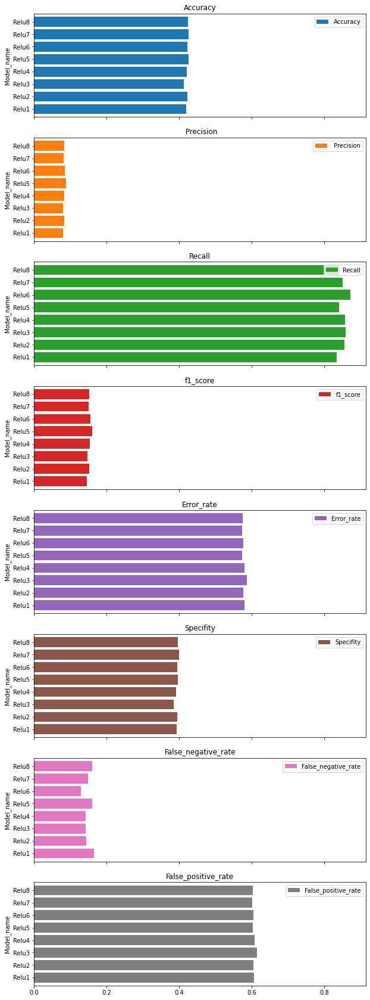

In [73]:
# Uncomment to plot
'''df_Relu.plot(kind = 'barh',
    width=0.8,
    subplots=True,
    figsize=(10,30));'''

#### Tahn Model's Comparations 

In [26]:
# Define weights for Sigmoid Function
L1_tanh1,L2_tanh1=weigths2(Model_Tanh_1)
L1_tanh2,L2_tanh2=weigths2(Model_Tanh_2)
L1_tanh3,L2_tanh3=weigths2(Model_Tanh_3)
L1_tanh4,L2_tanh4=weigths2(Model_Tanh_4)
L1_tanh5,L2_tanh5=weigths2(Model_Tanh_5)
L1_tanh6,L2_tanh6=weigths2(Model_Tanh_6)
L1_tanh7,L2_tanh7=weigths2(Model_Tanh_7)
L1_tanh8,L2_tanh8=weigths2(Model_Tanh_8)

binary_tanh1 = BinaryNeuralNetwork(L1_tanh1,L2_tanh1)
binary_tanh2 = BinaryNeuralNetwork(L1_tanh2,L2_tanh2)
binary_tanh3 = BinaryNeuralNetwork(L1_tanh3,L2_tanh3)
binary_tanh4 = BinaryNeuralNetwork(L1_tanh4,L2_tanh4)
binary_tanh5 = BinaryNeuralNetwork(L1_tanh5,L2_tanh5)
binary_tanh6 = BinaryNeuralNetwork(L1_tanh6,L2_tanh6)
binary_tanh7 = BinaryNeuralNetwork(L1_tanh7,L2_tanh7)
binary_tanh8 = BinaryNeuralNetwork(L1_tanh8,L2_tanh8)

In [27]:
# Descomentar y correr de a uno! 
with torch.no_grad():
    prediction_loader = test_batch
    #test_preds_Tanh1, test_labels_Tanh1 = get_all_preds(binary_tanh1, prediction_loader)
    #test_preds_Tanh2, test_labels_Tanh2 = get_all_preds(binary_tanh2, prediction_loader)
    #test_preds_Tanh3, test_labels_Tanh3 = get_all_preds(binary_tanh3, prediction_loader)
    #test_preds_Tanh4, test_labels_Tanh4 = get_all_preds(binary_tanh4, prediction_loader)
    #test_preds_Tanh5, test_labels_Tanh5 = get_all_preds(binary_tanh5, prediction_loader)
    #test_preds_Tanh6, test_labels_Tanh6 = get_all_preds(binary_tanh6, prediction_loader)
    #test_preds_Tanh7, test_labels_Tanh7 = get_all_preds(binary_tanh7, prediction_loader)
    test_preds_Tanh8, test_labels_Tanh8 = get_all_preds(binary_tanh8, prediction_loader)
    #test_preds_Tanh9, test_labels_Tanh9 = get_all_preds(binary_tanh9, prediction_loader)
    #test_preds_Tanh10, test_labels_Tanh10 = get_all_preds(binary_tanh10, prediction_loader)
    #test_preds_Tanh11, test_labels_Tanh11 = get_all_preds(binary_tanh11, prediction_loader)
    #test_preds_Tanh12, test_labels_Tanh12 = get_all_preds(binary_tanh12, prediction_loader)

tensor([[ 1.,  1.,  1.,  ..., -1., -1., -1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,
         1.,  1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1.,
        -1., -1., -1.,  1., -1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1., -1., -1., -1., -1.])
tensor([[ 1.,  1.,  1.,  ..., -1., -1., -1.],
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1., -1.],
        [ 1.,  1.,

In [90]:
# Uncomment
'''Tanh_metrics= Metrics('Tanh8',test_preds_Tanh8, test_labels_Tanh8)
print(Tanh_metrics)
with open("Tanh8", "rb") as f:
    obj = pickle.load(f)
print(obj)'''

['Tanh8', 0.49323232323232324, 0.22920065252854813, 0.8279316440777843, 0.35901367062731576, 0.5067676767676768, 0.4239912227233939, 0.17206835592221567, 0.5760087772766062]
['Tanh8', 0.49323232323232324, 0.22920065252854813, 0.8279316440777843, 0.35901367062731576, 0.5067676767676768, 0.4239912227233939, 0.17206835592221567, 0.5760087772766062]


In [91]:
#df_Tanh = pd.DataFrame.from_records(costr_list('Tanh'), columns=['Model_name', 'Accuracy', ' Precision', 'Recall', 'f1_score', 'Error_rate', 'Specifity', 'False_negative_rate', 'False_positive_rate' ], index="Model_name")

In [ ]:
#df_Tanh

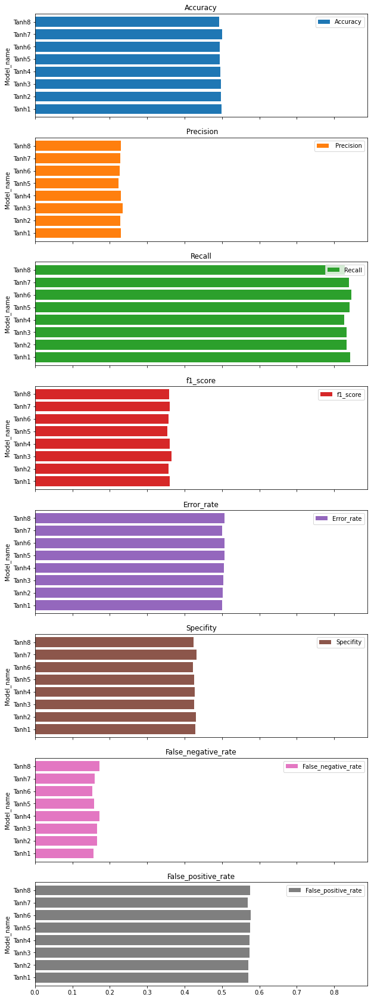

In [92]:
# Uncomment to plot
'''df_Tanh.plot(kind = 'barh',
    width=0.8,
    subplots=True,
    figsize=(10,30));'''

In [28]:
df_mejores = pd.DataFrame(columns=['Accuracy', ' Precision', 'Recall', 'f1_score', 'Error_rate', 'Specifity', 'False_negative_rate', 'False_positive_rate' ], index=['Sigmoid', 'Relu', 'Tanh'])
df_mejores

,Accuracy,Precision,Recall,f1_score,Error_rate,Specifity,False_negative_rate,False_positive_rate
Sigmoid,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Relu,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Tanh,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [96]:
#Compare better models 
'''
df_mejores.loc['Sigmoid']=df_Sigmoid.loc['Sigmoid5']
df_mejores.loc['Relu']=df_Relu.loc['Relu7']
df_mejores.loc['Tanh']=df_Tanh.loc['Tanh3']
df_mejores'''

,Accuracy,Precision,Recall,f1_score,Error_rate,Specifity,False_negative_rate,False_positive_rate
Sigmoid,0.794444,0.814589,0.844775,0.829407,0.205556,0.721563,0.155225,0.278437
Relu,0.426162,0.082212,0.850594,0.149933,0.573838,0.399313,0.149406,0.600687
Tanh,0.496768,0.23422,0.83343,0.365674,0.503232,0.425829,0.16657,0.574171


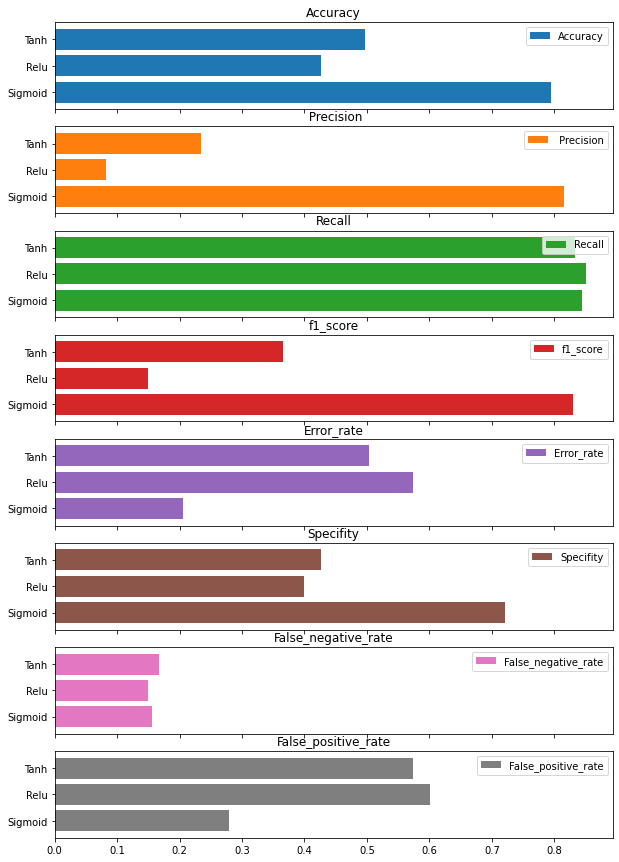

In [97]:
#Uncomment to plot
'''
df_mejores.plot(kind = 'barh',
    width=0.8,
    subplots=True,
    figsize=(10,15));'''